In [1]:
# Source: https://www.codementor.io/blog/text-classification-6mmol0q8oj
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer

from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import train_test_split

from sklearn.svm import LinearSVC
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier

In [2]:
ninety = open("all_whois_tld/whois_ninety_ls", "r").read().split("\n")
ten = open("all_whois_tld/whois_ten_ls", "r").read().split("\n")

In [3]:
import tqdm
dataset = []

for name in tqdm.tqdm(ninety):
    try:
        data = open(f"all_whois_tld/whois_ninety_final/{name}", "r").read()
        dataset.append((data, 0))
    except:
        pass
        
for name in tqdm.tqdm(ten):
    try:
        data = open(f"all_whois_tld/whois_ten_tld/{name}", "r").read()
        dataset.append((data, 1))
    except:
        pass
    
        

100%|██████████| 116093/116093 [00:02<00:00, 41705.97it/s]


In [14]:
from sklearn.model_selection import train_test_split
X = [a[0] for a in dataset]
y = [a[1] for a in dataset]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)
train = [(X_train[i], y_train[i]) for i in range(len(X_train))]
test = [(X_test[i], y_test[i]) for i in range(len(X_test))]

In [15]:
# Support Vector Machine + Count Vectorization
from nltk.corpus import stopwords
sw = stopwords.words('english')
sw += ["2020", "08", "07", "06"]
vectorizer = TfidfVectorizer(ngram_range=(1, 3), stop_words=sw)
# svm = LinearSVC()
X_train = vectorizer.fit_transform(X_train)
X_test = vectorizer.transform(X_test)
# _ = svm.fit(X_train, y_train)
# y_pred = svm.predict(X_test)
# print(classification_report(y_test, y_pred))

In [6]:
# print(confusion_matrix(y_test, y_pred))

In [7]:
# dt = DecisionTreeClassifier()
# dt.fit(X_train, y_train)
# y_pred = dt.predict(X_test)
# print(classification_report(y_test, y_pred))
# print(confusion_matrix(y_test, y_pred))

In [8]:
# dt = DecisionTreeClassifier(max_depth=4)
# dt.fit(X_train, y_train)
# y_pred = dt.predict(X_test)
# print(classification_report(y_test, y_pred))
# print(confusion_matrix(y_test, y_pred))

In [9]:
# from IPython.display import SVG
# from graphviz import Source
# from IPython.display import display
# graph = Source(
#     tree.export_graphviz(
#         dt,
#         out_file=None,
#         feature_names=vectorizer.get_feature_names(),
#         class_names=[str(a) for a in dt.classes_],
#         filled = True)
# )
# display(SVG(graph.pipe(format='svg')))

In [10]:
# tree.export_graphviz(
#         dt,
#         out_file="dt_full_final_whois.dot",
#         feature_names=vectorizer.get_feature_names(),
#         class_names=[str(a) for a in dt.classes_],
#         filled = True
# )

In [11]:
# rf = RandomForestClassifier()
# rf.fit(X_train, y_train)
# y_pred = rf.predict(X_test)
# print(classification_report(y_test, y_pred))
# print(confusion_matrix(y_test, y_pred))

In [16]:
from sklearn.linear_model import LogisticRegression
import numpy as np
logreg = LogisticRegression(random_state=0).fit(X_train, y_train)

log_preds = logreg.predict(X_test)
y_pred = (log_preds > 0.5).astype(np.int)

print(classification_report(y_test, y_pred))
print(confusion_matrix(y_test, y_pred))

/home/grapheo12/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)


              precision    recall  f1-score   support

           0       0.92      0.96      0.94     39903
           1       0.95      0.92      0.93     38603

    accuracy                           0.94     78506
   macro avg       0.94      0.94      0.94     78506
weighted avg       0.94      0.94      0.94     78506

[[38213  1690]
 [ 3251 35352]]


In [17]:
from sklearn.pipeline import make_pipeline
from lime.lime_text import LimeTextExplainer

logreg_pipeline = make_pipeline(vectorizer, logreg)
explainer = LimeTextExplainer(class_names=["90%_group", "10%_group"])


In [18]:
idx = 390
exp = explainer.explain_instance(test[idx][0], logreg_pipeline.predict_proba, num_features=10)

In [19]:
print("Actual label:", ["90%_group", "10%_group"][test[idx][1]])
print("Probabilities:", logreg_pipeline.predict_proba([test[idx][0]]))

Actual label: 10%_group
Probabilities: [[0.21615557 0.78384443]]


In [20]:
exp.show_in_notebook(text=True)

In [21]:
def explain_to_me(idx, pipeline=logreg_pipeline):
    exp = explainer.explain_instance(test[idx][0], pipeline.predict_proba, num_features=10)
    print("Actual label:", ["90%_group", "10%_group"][test[idx][1]])
    print("Probabilities:", logreg_pipeline.predict_proba([test[idx][0]]))
    exp.show_in_notebook(text=True)
    

In [22]:
for i in range(len(test)):
    if test[i][1] == 0:
        explain_to_me(i)


Actual label: 90%_group
Probabilities: [[0.74551638 0.25448362]]


Actual label: 90%_group
Probabilities: [[0.55820453 0.44179547]]


Actual label: 90%_group
Probabilities: [[0.9966674 0.0033326]]


Actual label: 90%_group
Probabilities: [[0.75809177 0.24190823]]


Actual label: 90%_group
Probabilities: [[0.73458879 0.26541121]]


Actual label: 90%_group
Probabilities: [[0.92433557 0.07566443]]


Actual label: 90%_group
Probabilities: [[0.80346927 0.19653073]]


Actual label: 90%_group
Probabilities: [[0.94243662 0.05756338]]


Actual label: 90%_group
Probabilities: [[0.99769951 0.00230049]]


Actual label: 90%_group
Probabilities: [[0.86613502 0.13386498]]


Actual label: 90%_group
Probabilities: [[0.81224619 0.18775381]]


ValueError: low >= high

In [16]:
from xgboost import XGBClassifier

xgclf = XGBClassifier(max_depth=4)
xgclf.fit(X_train, y_train)

y_pred = xgclf.predict(X_test)
print(classification_report(y_test, y_pred))
print(confusion_matrix(y_test, y_pred))


              precision    recall  f1-score   support

           0       0.93      0.97      0.95     39903
           1       0.97      0.92      0.95     38603

    accuracy                           0.95     78506
   macro avg       0.95      0.95      0.95     78506
weighted avg       0.95      0.95      0.95     78506

[[38891  1012]
 [ 3007 35596]]


In [17]:
# XGBoost most important features in decreasing order of importance
# BiLSTM-CRA
# By hand check true positives and false positives
# 5-fold CV
# Scale up to all the data (10% bad + 10% good)
# Precision, Recall, F1-score, area under Precision, Recall graph

# IP Address same and different (for 90% and 10%)
# Country wise difference
# If 2 countries with different types of legislation share similar certificates

# FIND INSIGHTS

In [18]:
from collections import Counter

features = Counter(dict(zip(vectorizer.get_feature_names(), xgclf.feature_importances_)))

In [19]:
features.most_common()[:500]

[('database 2020 07', 0.42230073),
 ('2020 08', 0.13964994),
 ('database 2020 08', 0.08950679),
 ('2020 07', 0.07110117),
 ('ns cloudflare', 0.018987605),
 ('date 2020 08', 0.007274117),
 ('last update 2019', 0.0069036037),
 ('service 35', 0.006654039),
 ('last update 2020', 0.0061468855),
 ('act', 0.0047765337),
 ('130 211', 0.004651116),
 ('on 2020 07', 0.0042185658),
 ('34 67', 0.0041993363),
 ('225 43', 0.003927999),
 ('following terms', 0.0038869681),
 ('197', 0.0038164586),
 ('html', 0.0032629333),
 ('server version', 0.0031555581),
 ('agency traficom', 0.003129376),
 ('146 158', 0.0030675675),
 ('248 157', 0.0029144923),
 ('202 84', 0.002863486),
 ('134 236', 0.0027430702),
 ('registrylock', 0.0025471558),
 ('aug', 0.0024671769),
 ('modified 2019', 0.0024317857),
 ('on 2020 08', 0.0024049059),
 ('per', 0.0024006746),
 ('intended', 0.0023883004),
 ('exceeded', 0.0021823498),
 ('see', 0.0021120438),
 ('23 jun', 0.0020309782),
 ('214', 0.0019854489),
 ('jul 2020 this', 0.001959019)

In [19]:
true_0_pred_1 = [a[0] for a in enumerate(list((np.array(y_test) == 0) * (np.array(y_pred) == 1))) if a[1]]
true_1_pred_0 = [a[0] for a in enumerate(list((np.array(y_test) == 1) * (np.array(y_pred) == 0))) if a[1]]

In [20]:
X_train[0]

<1x3261665 sparse matrix of type '<class 'numpy.float64'>'
	with 1926 stored elements in Compressed Sparse Row format>

In [21]:
true_0_pred_1_data = [train[x][0] for x in true_0_pred_1]
for record in true_0_pred_1_data[:100]:
    print(record)
    print("============================================================================")

   Domain Name: WE5588.NET
   Registry Domain ID: 2186616472_DOMAIN_NET-VRSN
   Registrar WHOIS Server: whois.godaddy.com
   Registrar URL: http://www.godaddy.com
   Updated Date: 2019-11-05T02:22:26Z
   Creation Date: 2017-11-13T03:04:33Z
   Registry Expiry Date: 2020-11-13T03:04:33Z
   Registrar: GoDaddy.com, LLC
   Registrar IANA ID: 146
   Registrar Abuse Contact Email: abuse@godaddy.com
   Registrar Abuse Contact Phone: 480-624-2505
   Domain Status: clientDeleteProhibited https://icann.org/epp#clientDeleteProhibited
   Domain Status: clientRenewProhibited https://icann.org/epp#clientRenewProhibited
   Domain Status: clientTransferProhibited https://icann.org/epp#clientTransferProhibited
   Domain Status: clientUpdateProhibited https://icann.org/epp#clientUpdateProhibited
   Name Server: BRENDA.NS.CLOUDFLARE.COM
   Name Server: ERIC.NS.CLOUDFLARE.COM
   DNSSEC: unsigned
   URL of the ICANN Whois Inaccuracy Complaint Form: https://www.icann.org/wicf/
>>> Last update of whois databa

/home/grapheo12/anaconda3/lib/python3.7/importlib/_bootstrap.py:219: RuntimeWarning: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject
  return f(*args, **kwds)


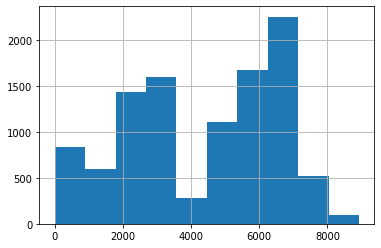

In [22]:
import pandas as pd
pd.Series([len(r) for r in true_0_pred_1_data]).hist()

In [23]:
true_1_pred_0_data = [train[x][0] for x in true_1_pred_0]
for record in true_0_pred_1_data:
    print(record)
    print("============================================================================")

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



   Domain Name: BOOKCROSSING.COM
   Registry Domain ID: 67993818_DOMAIN_COM-VRSN
   Registrar WHOIS Server: whois.enom.com
   Registrar URL: http://www.enom.com
   Updated Date: 2020-02-19T08:51:02Z
   Creation Date: 2001-03-19T08:38:26Z
   Registry Expiry Date: 2021-03-19T07:38:26Z
   Registrar: eNom, LLC
   Registrar IANA ID: 48
   Registrar Abuse Contact Email:
   Registrar Abuse Contact Phone:
   Domain Status: clientTransferProhibited https://icann.org/epp#clientTransferProhibited
   Name Server: DNS1.NAME-SERVICES.COM
   Name Server: DNS2.NAME-SERVICES.COM
   Name Server: DNS3.NAME-SERVICES.COM
   Name Server: DNS4.NAME-SERVICES.COM
   Name Server: DNS5.NAME-SERVICES.COM
   DNSSEC: unsigned
   URL of the ICANN Whois Inaccuracy Complaint Form: https://www.icann.org/wicf/
>>> Last update of whois database: 2020-08-18T10:26:21Z <<<

For more information on Whois status codes, please visit https://icann.org/epp

NOTICE: The expiration date displayed in this record is the date the
reg

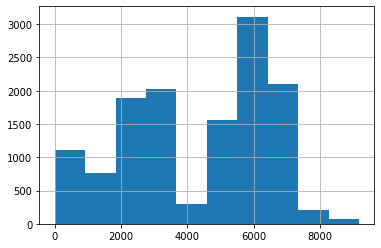

In [24]:
pd.Series([len(r) for r in true_1_pred_0_data]).hist()

In [25]:
true_0_pred_0 = [a[0] for a in enumerate(list((np.array(y_test) == 0) * (np.array(y_pred) == 0))) if a[1]]
true_1_pred_1 = [a[0] for a in enumerate(list((np.array(y_test) == 1) * (np.array(y_pred) == 1))) if a[1]]

In [26]:
true_1_pred_1_data = [train[x][0] for x in true_1_pred_1]
true_0_pred_0_data = [train[x][0] for x in true_0_pred_0]

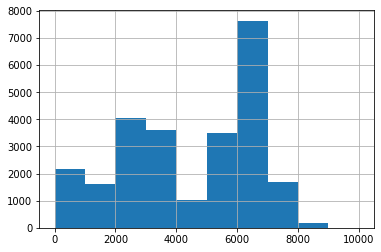

In [27]:
pd.Series([len(r) for r in true_1_pred_1_data]).hist(bins=10, range=[0, 10000])

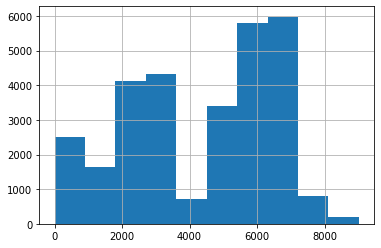

In [28]:
pd.Series([len(r) for r in true_0_pred_0_data]).hist()

In [29]:
for record in true_1_pred_1_data[:100]:
    print(record)
    print("============================================================================")

   Domain Name: GARVITGUPTA.COM
   Registry Domain ID: 1892648970_DOMAIN_COM-VRSN
   Registrar WHOIS Server: whois.crazydomains.com
   Registrar URL: http://www.crazydomains.com.au
   Updated Date: 2019-12-27T19:00:40Z
   Creation Date: 2014-12-27T09:52:43Z
   Registry Expiry Date: 2020-12-27T09:52:43Z
   Registrar: Dreamscape Networks International Pte Ltd
   Registrar IANA ID: 1291
   Registrar Abuse Contact Email: abuse@crazydomains.com
   Registrar Abuse Contact Phone: +61 894 220 890
   Domain Status: ok https://icann.org/epp#ok
   Name Server: OWEN.NS.CLOUDFLARE.COM
   Name Server: SHARON.NS.CLOUDFLARE.COM
   DNSSEC: unsigned
   URL of the ICANN Whois Inaccuracy Complaint Form: https://www.icann.org/wicf/
>>> Last update of whois database: 2020-07-07T01:03:33Z <<<

For more information on Whois status codes, please visit https://icann.org/epp

NOTICE: The expiration date displayed in this record is the date the
registrar's sponsorship of the domain name registration in the regist

In [30]:
def word_percentage(s):
    s = s.lower()
    print(
        sum([1 for a in true_0_pred_0_data if s in a.lower()]) / len(true_0_pred_0_data) * 100,
        sum([1 for a in true_1_pred_1_data if s in a.lower()]) / len(true_1_pred_1_data) * 100,
        sum([1 for a in true_1_pred_0_data if s in a.lower()]) / len(true_1_pred_0_data) * 100,
        sum([1 for a in true_0_pred_1_data if s in a.lower()]) / len(true_0_pred_1_data) * 100,
        sep='\n'
    )

In [31]:
word_percentage("cloudflare")

25.827657483650164
25.609421000981353
25.411334552102378
25.92378752886836


In [32]:
word_percentage("redacted")

12.927383009725189
12.73405299313052
13.025594149908592
12.58660508083141


In [33]:
def len_percentage(n):
    return np.array([
        sum([1 for a in true_0_pred_0_data if len(a) <= n]) / len(true_0_pred_0_data) * 100,
        sum([1 for a in true_1_pred_1_data if len(a) <= n]) / len(true_1_pred_1_data) * 100,
        sum([1 for a in true_1_pred_0_data if len(a) <= n]) / len(true_1_pred_0_data) * 100,
        sum([1 for a in true_0_pred_1_data if len(a) <= n]) / len(true_0_pred_1_data) * 100,
    ])
    

In [34]:
dummy_base = """>>> Last update of whois database 2020-07-20T23:59:50Z <<<
NOTICE The expiration date displayed in this record is the date the
TERMS OF USE You are not authorized to access or query our Whois
by the following terms of use You agree that you may use this Data only
to (1) allow, enable, or otherwise support the transmission of mass"""
n = len(dummy_base)
print(len_percentage(n+1) - len_percentage(n))

[0.00338857 0.00392542 0.00761731 0.01924557]


In [35]:
len_percentage(5)

array([1.00979296, 1.02060844, 1.00548446, 0.99114704])

In [36]:
len_percentage(n+1)

array([3.89346345, 4.15309127, 3.91529555, 3.8491147 ])

In [65]:
# 5-fold Cross Validation

dataset = train + test
X = np.array([a[0] for a in dataset])
y = np.array([a[1] for a in dataset])

X[0]

MemoryError: Unable to allocate 376. GiB for an array with shape (237895,) and data type <U424252

              precision    recall  f1-score   support

           0       0.94      0.84      0.89      1999
           1       0.86      0.94      0.90      2000

    accuracy                           0.89      3999
   macro avg       0.90      0.89      0.89      3999
weighted avg       0.90      0.89      0.89      3999

[[1687  312]
 [ 112 1888]]


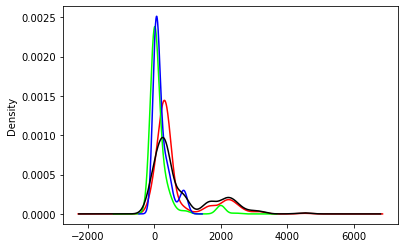

[74.80735033 60.96398305 76.78571429 88.14102564]
              precision    recall  f1-score   support

           0       0.94      0.85      0.89      1999
           1       0.86      0.94      0.90      2000

    accuracy                           0.90      3999
   macro avg       0.90      0.90      0.90      3999
weighted avg       0.90      0.90      0.90      3999

[[1700  299]
 [ 112 1888]]


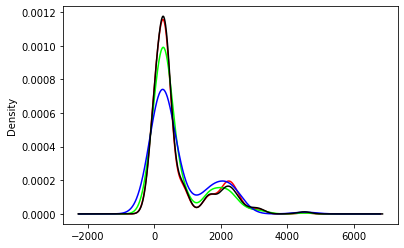

[69.58823529 69.65042373 65.17857143 67.89297659]
              precision    recall  f1-score   support

           0       0.93      0.86      0.89      1999
           1       0.87      0.94      0.90      2000

    accuracy                           0.90      3999
   macro avg       0.90      0.90      0.90      3999
weighted avg       0.90      0.90      0.90      3999

[[1714  285]
 [ 121 1879]]


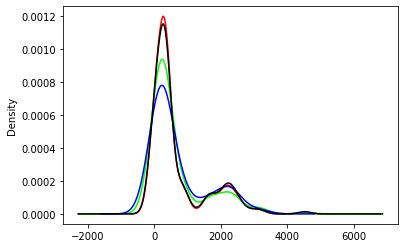

[70.42007001 68.44065993 66.11570248 70.52631579]
              precision    recall  f1-score   support

           0       0.94      0.85      0.89      1999
           1       0.86      0.95      0.90      2000

    accuracy                           0.90      3999
   macro avg       0.90      0.90      0.90      3999
weighted avg       0.90      0.90      0.90      3999

[[1693  306]
 [ 102 1898]]


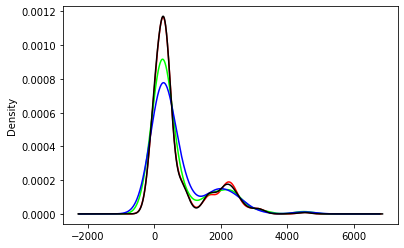

[69.46249262 69.33614331 66.66666667 69.93464052]
              precision    recall  f1-score   support

           0       0.95      0.82      0.88      1999
           1       0.84      0.95      0.89      2000

    accuracy                           0.89      3999
   macro avg       0.89      0.89      0.89      3999
weighted avg       0.89      0.89      0.89      3999

[[1639  360]
 [  90 1910]]


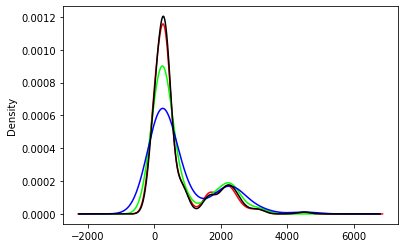

[69.92068334 70.         65.55555556 64.44444444]


In [36]:
# For ease of use, let's define a pipeline

from sklearn.pipeline import Pipeline
from sklearn.model_selection import StratifiedKFold
import matplotlib.pyplot as plt

pipeline = Pipeline([
    ('vectorizer', TfidfVectorizer(ngram_range=(1, 5), max_df=0.5)),
    ('model', XGBClassifier(max_depth=4))
])

skf = StratifiedKFold(n_splits=5)
for train_index, test_index in skf.split(X, y):
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]
    pipeline.fit(X_train, y_train)
    y_pred = pipeline.predict(X_test)
    print(classification_report(y_test, y_pred))
    print(confusion_matrix(y_test, y_pred))
    
    true_0_pred_0 = [a[0] for a in enumerate(list((np.array(y_test) == 0) * (np.array(y_pred) == 0))) if a[1]]
    true_1_pred_1 = [a[0] for a in enumerate(list((np.array(y_test) == 1) * (np.array(y_pred) == 1))) if a[1]]
    true_0_pred_1 = [a[0] for a in enumerate(list((np.array(y_test) == 0) * (np.array(y_pred) == 1))) if a[1]]
    true_1_pred_0 = [a[0] for a in enumerate(list((np.array(y_test) == 1) * (np.array(y_pred) == 0))) if a[1]]
    true_1_pred_1_data = [train[x][0] for x in true_1_pred_1]
    true_0_pred_0_data = [train[x][0] for x in true_0_pred_0]
    true_0_pred_1_data = [train[x][0] for x in true_0_pred_1]
    true_1_pred_0_data = [train[x][0] for x in true_1_pred_0]
    
    pd.Series([len(r) for r in true_0_pred_0_data]).plot.kde(color='#ff0000')
    pd.Series([len(r) for r in true_0_pred_1_data]).plot.kde(color='#00ff00')
    pd.Series([len(r) for r in true_1_pred_0_data]).plot.kde(color='#0000ff')
    pd.Series([len(r) for r in true_1_pred_1_data]).plot.kde(color='#000000')
    plt.show()
    
    print(len_percentage(n+1))
    print("=============================================================")

In [37]:
features = Counter(dict(zip(
    pipeline['vectorizer'].get_feature_names(),
    pipeline['model'].feature_importances_)))

features.most_common(50)

[('database 2020 07', 0.43785653),
 ('2020 06', 0.24069828),
 ('database 2020 06', 0.049199812),
 ('and', 0.009010156),
 ('www', 0.0074811867),
 ('cloudflare', 0.0073927906),
 ('invalid', 0.00587713),
 ('status', 0.0039155334),
 ('requests', 0.0037058296),
 ('web', 0.0032037378),
 ('use of', 0.0030815366),
 ('domain registry', 0.0029161312),
 ('com status', 0.0028186287),
 ('administrative', 0.0023502493),
 ('number', 0.0023450158),
 ('dns2', 0.0022989716),
 ('2021', 0.0021791402),
 ('advertising', 0.0021495756),
 ('available to', 0.0021429462),
 ('br created', 0.0021340344),
 ('cloudflare com dnssec', 0.0020828047),
 ('nestle', 0.0020361808),
 ('source', 0.0019889153),
 ('domain status ok registrant', 0.0019769152),
 ('feb', 0.0019660443),
 ('for webbased', 0.0019621837),
 ('en', 0.001936346),
 ('domains whois', 0.001915405),
 ('nserver ns', 0.0017769908),
 ('2020 11', 0.0017739397),
 ('registrar', 0.0017389999),
 ('contact', 0.001735778),
 ('goettingen', 0.001725889),
 ('name servers

In [46]:
from wordcloud import WordCloud

wc = WordCloud(max_words=6000, width=800, height=600, margin=10, random_state=1).fit_words(features)

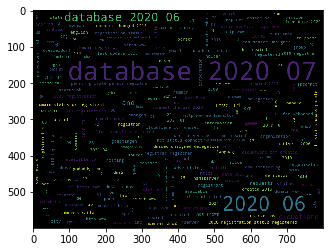

In [47]:
plt.imshow(wc)

In [48]:
wc.to_file("xgboost_wordcloud.png")